In [2]:
import os,sys
import pandas as pd
import collections
import matplotlib
from collections import defaultdict, Counter

import sourmash
from sourmash.lca import lca_utils

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import seaborn as sns

figs_path = os.path.abspath(os.path.join('../figs'))
if figs_path not in sys.path:
    sys.path.append(figs_path)
    
from sourmash_sankey import GenomeSankeyFlow

In [3]:
pd.__version__

'1.1.3'

In [4]:
from IPython.display import display, Markdown

In [5]:
pathInfo = pd.read_csv("../gtdb95-evolpaths.csv.gz")
pathInfo

,accession,path,rank,lineage
0,GCA_003661365.1,path1,superkingdom,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
1,GCA_003661365.1,path2,superkingdom,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
2,GCA_003661365.1,path3,superkingdom,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
3,GCA_003661365.1,path4,superkingdom,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
4,GCA_003661365.1,path5,superkingdom,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
...,...,...,...,...
20694,GCA_002774315.1,path2957,phylum,d__Bacteria;p__WOR-3;c__UBA3073;o__UBA3073;f__...
20695,GCA_003645615.1,path2957,order,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__B3...
20696,GCA_001303785.1,path2957,family,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__SM...
20697,GCA_001303225.1,path2957,genus,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__SM...


In [6]:
genome_info = pathInfo.drop(columns=["path", "rank"])
genome_info.drop_duplicates(inplace=True)
genome_info 

,accession,lineage
0,GCA_003661365.1,d__Archaea;p__Thermoproteota;c__Korarchaeia;o_...
52,GCA_001940645.1,d__Archaea;p__Asgardarchaeota;c__Heimdallarcha...
54,GCA_005191425.1,d__Archaea;p__Asgardarchaeota;c__Lokiarchaeia;...
56,GCA_004524545.1,d__Archaea;p__Asgardarchaeota;c__Lokiarchaeia;...
58,GCA_004375715.1,d__Archaea;p__Asgardarchaeota;c__Lokiarchaeia;...
...,...,...
20694,GCA_002774315.1,d__Bacteria;p__WOR-3;c__UBA3073;o__UBA3073;f__...
20695,GCA_003645615.1,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__B3...
20696,GCA_001303785.1,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__SM...
20697,GCA_001303225.1,d__Bacteria;p__WOR-3;c__WOR-3;o__SM23-42;f__SM...


In [7]:
def make_lineages(row):
    row["lineage"] = lca_utils.make_lineage(row["lineage"])
    return row

In [8]:
genome_info = genome_info.apply(make_lineages, axis=1)
genome_info

,accession,lineage
0,GCA_003661365.1,"((superkingdom, d__Archaea), (phylum, p__Therm..."
52,GCA_001940645.1,"((superkingdom, d__Archaea), (phylum, p__Asgar..."
54,GCA_005191425.1,"((superkingdom, d__Archaea), (phylum, p__Asgar..."
56,GCA_004524545.1,"((superkingdom, d__Archaea), (phylum, p__Asgar..."
58,GCA_004375715.1,"((superkingdom, d__Archaea), (phylum, p__Asgar..."
...,...,...
20694,GCA_002774315.1,"((superkingdom, d__Bacteria), (phylum, p__WOR-..."
20695,GCA_003645615.1,"((superkingdom, d__Bacteria), (phylum, p__WOR-..."
20696,GCA_001303785.1,"((superkingdom, d__Bacteria), (phylum, p__WOR-..."
20697,GCA_001303225.1,"((superkingdom, d__Bacteria), (phylum, p__WOR-..."


In [9]:
lineageD = pd.Series(genome_info.lineage.values,index=genome_info.accession).to_dict()

In [10]:
all_lineages = list(lineageD.values())

In [11]:
all_lineages[0]

(LineagePair(rank='superkingdom', name='d__Archaea'),
 LineagePair(rank='phylum', name='p__Thermoproteota'),
 LineagePair(rank='class', name='c__Korarchaeia'),
 LineagePair(rank='order', name='o__Korarchaeales'),
 LineagePair(rank='family', name='f__QMVU01'),
 LineagePair(rank='genus', name='g__QMVU01'),
 LineagePair(rank='species', name='s__QMVU01 sp003661365'))

## Try making sunburst plots

In [12]:
def get_parent_and_names(row):
    lineage = row["lineage"]
    if lineage[-1][0] == "superkingdom":
        row["parent"] = None
    else:
        row["parent"] = lineage[:-1]
        row["parent_name"] = lineage[:-1][-1][1][3:]
    row["name"] = lineage[-1][1][3:]
    row["superkingdom"] = lineage[0][1][3:]
#    row["color"] = obj.colors[lineage]

  # row[]
    return row


def build_hierarchical_lineage_dataframe(lineages, stop_rank="genus"):
    """
    Build a hierarchy of levels for Sunburst or Treemap charts.

    Levels are given starting from the bottom to the top of the hierarchy,
    ie the last level corresponds to the root.
    """
    taxlist = list(lca_utils.taxlist(include_strain=False))
    stop_index = taxlist.index(stop_rank)
    print(stop_index)
    truncated_taxlist = taxlist[:stop_index+1]
    print(truncated_taxlist)
    lineageCounts = defaultdict(int)
    # get hierachical counts!
    for lin in lineages:
        for rank in truncated_taxlist:
            ranklin = lca_utils.pop_to_rank(lin, rank)
            lineageCounts[ranklin]+=1
    
    # now make dataframe
    hDF = pd.DataFrame.from_dict(lineageCounts, orient='index', columns=['counts']).reset_index()
    hDF.rename(columns={"index": "lineage"}, inplace=True)
    hDF=hDF.apply(get_parent_and_names, axis=1)
    return hDF


    #print(hDF.head())
df= build_hierarchical_lineage_dataframe(all_lineages, stop_rank="phylum")
df.tail()

1
['superkingdom', 'phylum']


,counts,lineage,name,parent,parent_name,superkingdom
30,287,"((superkingdom, d__Bacteria), (phylum, p__Pate...",Patescibacteria,"((superkingdom, d__Bacteria),)",Bacteria,Bacteria
31,150,"((superkingdom, d__Bacteria), (phylum, p__Plan...",Planctomycetota,"((superkingdom, d__Bacteria),)",Bacteria,Bacteria
32,76,"((superkingdom, d__Bacteria), (phylum, p__Spir...",Spirochaetota,"((superkingdom, d__Bacteria),)",Bacteria,Bacteria
33,152,"((superkingdom, d__Bacteria), (phylum, p__Verr...",Verrucomicrobiota,"((superkingdom, d__Bacteria),)",Bacteria,Bacteria
34,11,"((superkingdom, d__Bacteria), (phylum, p__WOR-3))",WOR-3,"((superkingdom, d__Bacteria),)",Bacteria,Bacteria


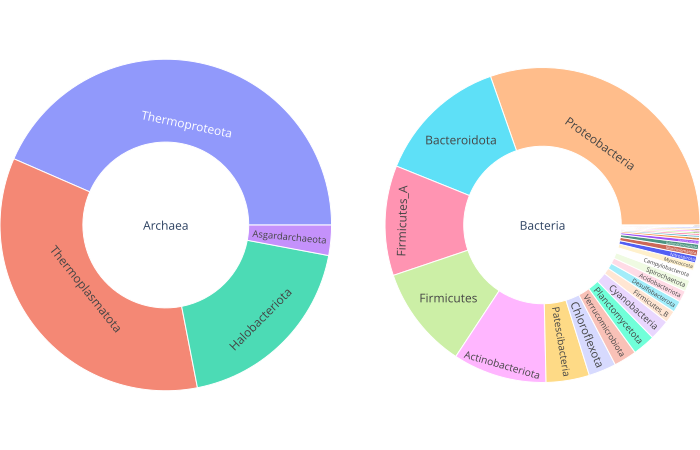

In [13]:
fig = make_subplots(1, 2, specs=[[{"type": "domain"}, {"type": "domain"}]],)

#obj.colors[lin]

#fig = go.Figure()
archaea_df=df[df["superkingdom"] =="Archaea"]
bacteria_df=df[df["superkingdom"] =="Bacteria"]

fig.add_trace(go.Sunburst(
    labels=archaea_df['name'],
    parents=archaea_df['parent_name'],
    values=archaea_df['counts'],
    branchvalues='total',
    domain=dict(column=0),
    #marker=dict(
    #    colors=df_all_trees['color'],
    #    colorscale='RdBu',
    #    cmid=average_score),
    #hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    #name='Archaea',
    ))
fig.add_trace(go.Sunburst(
    labels=bacteria_df['name'],
    parents=bacteria_df['parent_name'],
    values=bacteria_df['counts'],
    branchvalues='total',
    domain=dict(column=1),
    #insidetextorientation='radial',
    maxdepth=2,
    #marker=dict(
    #    colors=df_all_trees['color'],
    #    colorscale='RdBu',
    #    cmid=average_score),
    #hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    #name='Bacteria'
    ), 1, 2)

fig.update_layout(
    grid= dict(columns=2, rows=1),
    margin = dict(t=0, l=0, r=0, b=0)
)

fig.show("svg")
#fig.write_html('gtdb95-evolpaths-taxonomysunburst.phylum.html', auto_open=True)


In [14]:
def color_by_rank(obj, counts, color_rank="phylum", color_lineage_subset=None, alt_palette_map=None, returnDF=False):
    "select colors based on taxonomy at given color rank"
    palette_map={"d__Bacteria": "crest",  "d__Archaea": "flare", "d__Eukaryota": "viridis"}
    if alt_palette_map:
        palette_map.update(alt_palette_map)
    full_lins = list(counts.keys())
    
    color_lins = defaultdict(list)
    # first pass: count items to color (by superk)
    for lin in full_lins:
        superk = lca_utils.pop_to_rank(lin, "superkingdom")[0].name
        #color_lins[superk]+=1
        color_lins[superk].append(lca_utils.pop_to_rank(lin, color_rank))
    
    # now generate color lists for each superkingdom
    colors_to_use=defaultdict()
    for superk in color_lins.keys():
        if superk not in palette_map.keys():
            print(f"yikes, unknown superkingdom! Please provide an 'alt_palette_map' dictionary mapping superkingdom {superk} to a continuous color brewer palette (e.g. crest, flare, etc)")
        else:
            #for superk, clins in color_lins.items():
            clins = color_lins[superk]
            palette = palette_map[superk]
            these_colors = sns.color_palette(palette, n_colors=len(set(clins))).as_hex()
            color_map = {}
            for cl in clins:
                # set colors sequentially, only using new ones when we have a new key
                if cl not in color_map.keys():
                    color_map[cl] = these_colors.pop()
            colors_to_use[superk] = color_map
                # assign colors
                
    # second pass: assign colors
    color_this_lin=True
    for lin in full_lins:
        superk = lca_utils.pop_to_rank(lin, "superkingdom")[0].name
        ## enable selective coloration
        if color_lineage_subset:
            color_this_lin=False
            for subset_lin in color_lineage_subset:
                if lca_utils.is_lineage_match(subset_lin, lin, subset_lin[-1].rank):
                    color_this_lin=True
                    break
        if color_this_lin:
            color_lin = lca_utils.pop_to_rank(lin, color_rank)
            obj.colors[lin] = colors_to_use[superk][color_lin]

In [15]:
def make_sunburst_fig(obj, title):
    "Build a plotly figure/sankey diagram."
    # make the data to go into the sankey figure.
    labels = obj.make_labels()
    src_l, dest_l, cnt_l, color_l, label_l = obj.make_lists()
    
    fig.add_trace(go.Sunburst(
        ids=dest_l[:20],
        labels=label_l[:20],
        parents=src_l[:20],
        values=cnt_l[:20],
        #domain=dict(column=1),
        maxdepth=2,
        insidetextorientation='radial'
     ))
    if title:
        fig.update_layout(title_text=title, font_size=10)

    return fig

In [16]:
def lineages_to_sunburst(title, lineages, stop_rank="genus", color_rank="phylum", color_lineage_subset=None):
    obj = GenomeSankeyFlow(stop_rank=stop_rank, count_item="genomes")
    counts = collections.Counter()
    num_bact=0
    num_arch=0
    for lin in lineages:
        gl = lca_utils.pop_to_rank(lin, stop_rank)
        counts[gl] +=1
    color_by_rank(obj, counts, color_rank, color_lineage_subset=color_lineage_subset)
    obj.make_links(counts)
    fig = make_sunburst_fig(obj, title)
    return fig

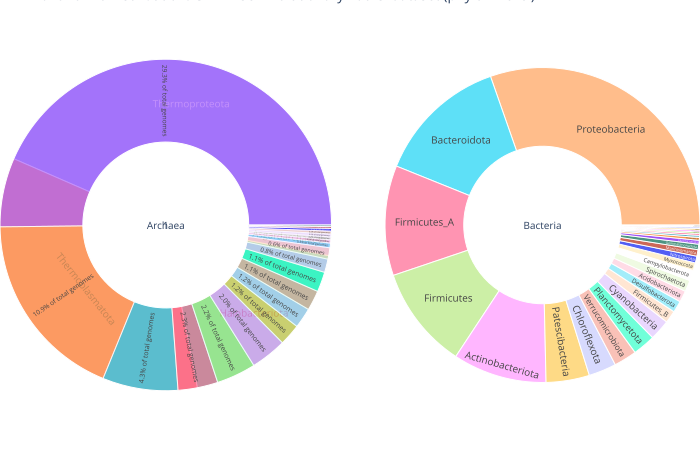

In [17]:
title = "Taxonomic Distribution: GTDB r95 'Evolutionary Paths' dataset (phylum-level)"
fig = lineages_to_sunburst(title, all_lineages, stop_rank="phylum")
#fig.write_html('gtdb95-evolpaths-taxonomysankey.phylum.html', auto_open=True)
fig.show("svg")

In [18]:
stop_rank="phylum"
lineages=all_lineages
color_rank="phylum"
color_lineage_subset=None
obj = GenomeSankeyFlow(stop_rank=stop_rank, count_item="genomes")
counts = collections.Counter()
num_bact=0
num_arch=0
for lin in all_lineages:
    gl = lca_utils.pop_to_rank(lin, stop_rank)
    counts[gl] +=1
color_by_rank(obj, counts, color_rank, color_lineage_subset=color_lineage_subset)
obj.make_links(counts)
labels = obj.make_labels()
src_l, dest_l, cnt_l, color_l, label_l = obj.make_lists()
total_counts = obj.sum_counts
print(total_counts)


6690


33


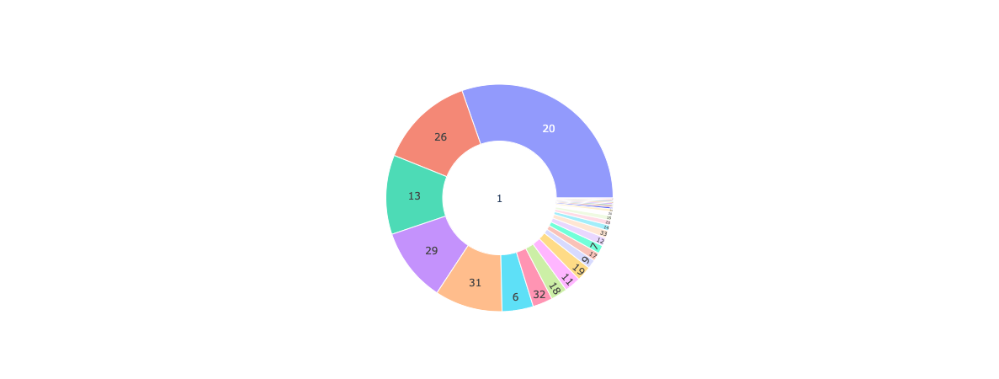

In [19]:
print(len(dest_l))
fig =go.Figure(go.Sunburst(
    labels=dest_l[:29],
    parents=src_l[:29],
    values=cnt_l[:29],
))
fig.show()
#fig.write_html('test-sunburst.html', auto_open=True)


In [20]:
#make dataframe to use express?
linkDF = pd.DataFrame(
    {'source': src_l,
     'dest': dest_l,
     'count': cnt_l,
     'color': color_l,
     'label': label_l
    })
linkDF.head()

,source,dest,count,color,label
0,1,0,10,#234f81,0.1% of total genomes
1,1,2,18,#398a8e,0.3% of total genomes
2,1,5,7,#509e90,0.1% of total genomes
3,1,6,287,#76b791,4.3% of total genomes
4,1,7,76,#2a3d78,1.1% of total genomes


In [21]:
def split_lineages_to_columns(row):
    #rank_d = {"d__": "superkingdom", "p__": "phylum", "c__": "class", "o__": "order", "f__": "family", "g__": "genus", "s__": "species"}
    # split taxonomy column on ";"
    lineages = row["lineage"].split(";")
    row["superkingdom"] = lineages[0].split("d__")[1]
    row["phylum"] = lineages[1].split("p__")[1]
    row["class"] = lineages[2].split("c__")[1]
    row["order"] = lineages[3].split("o__")[1]
    row["family"] = lineages[4].split("f__")[1]
    row["genus"] = lineages[5].split("g__")[1]
    row["species"] = lineages[6].split("s__")[1]
    row["strain"] = ""
    return row


In [22]:
pathInfo = pathInfo.apply(split_lineages_to_columns, axis=1)

In [23]:
gDF = pathInfo.drop(columns = ["lineage", "strain"])

In [24]:
gDF["count"] = 1

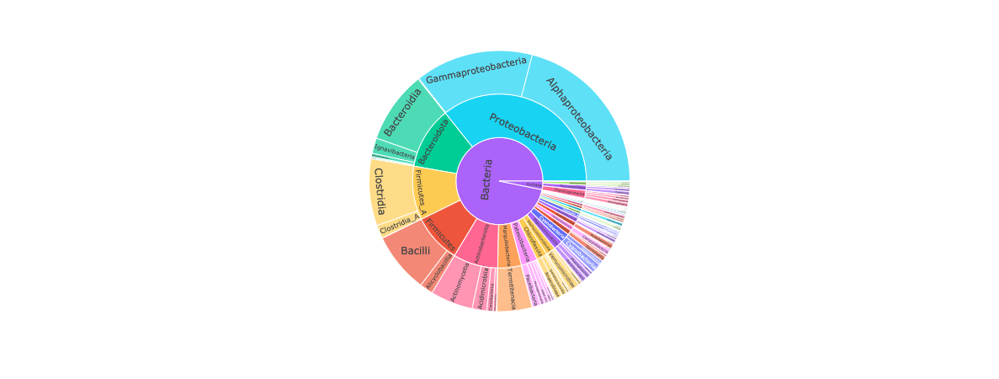

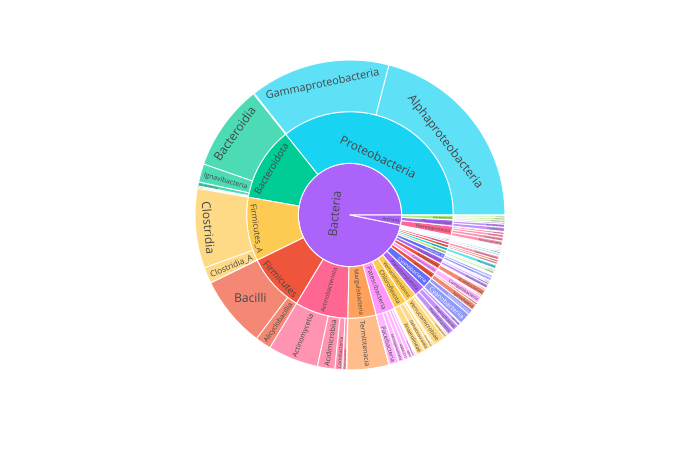

In [25]:
fig = px.sunburst(gDF, path=['superkingdom', 'phylum', 'class'], values='count',
                  color='phylum',# hover_data=['iso_alpha'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=gDF['count']/6690)
                  #color_continuous_midpoint=np.average(df['lifeExp'], weights=df['pop']))

fig.show()
fig.show("svg")
#df.head()

In [26]:
# make dataframes of unique genomes
uDF = gDF.drop(columns=["rank", "path"]).drop_duplicates()

arch_df = uDF[uDF["superkingdom"] == "Archaea"]
bact_df = uDF[uDF["superkingdom"] == "Bacteria"]
uDF

,accession,superkingdom,phylum,class,order,family,genus,species,count
0,GCA_003661365.1,Archaea,Thermoproteota,Korarchaeia,Korarchaeales,QMVU01,QMVU01,QMVU01 sp003661365,1
52,GCA_001940645.1,Archaea,Asgardarchaeota,Heimdallarchaeia,LC-3,LC-3,LC-3,LC-3 sp001940645,1
54,GCA_005191425.1,Archaea,Asgardarchaeota,Lokiarchaeia,Helarchaeales,HEL-GB-B,HEL-GB-B,HEL-GB-B sp005191425,1
56,GCA_004524545.1,Archaea,Asgardarchaeota,Lokiarchaeia,CR-4,AMARA-1,AMARA-1,AMARA-1 sp004524545,1
58,GCA_004375715.1,Archaea,Asgardarchaeota,Lokiarchaeia,CR-4,SOKP01,SOKP01,SOKP01 sp004375715,1
...,...,...,...,...,...,...,...,...,...
20694,GCA_002774315.1,Bacteria,WOR-3,UBA3073,UBA3073,UBA3073,UBA3073,UBA3073 sp002774315,1
20695,GCA_003645615.1,Bacteria,WOR-3,WOR-3,SM23-42,B36-G15,B36-G15,B36-G15 sp003645615,1
20696,GCA_001303785.1,Bacteria,WOR-3,WOR-3,SM23-42,SM23-42,SM23-42,SM23-42 sp001303785,1
20697,GCA_001303225.1,Bacteria,WOR-3,WOR-3,SM23-42,SM23-42,DG-78,DG-78 sp001303225,1


In [99]:
# write unique df to csv file

uDF.drop(columns=["count"]).to_csv("evolpaths_genomes.lineages.csv", index=False)

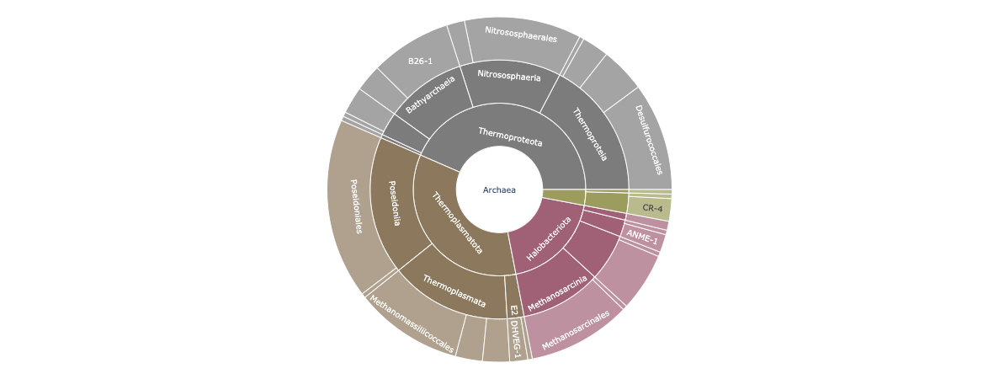

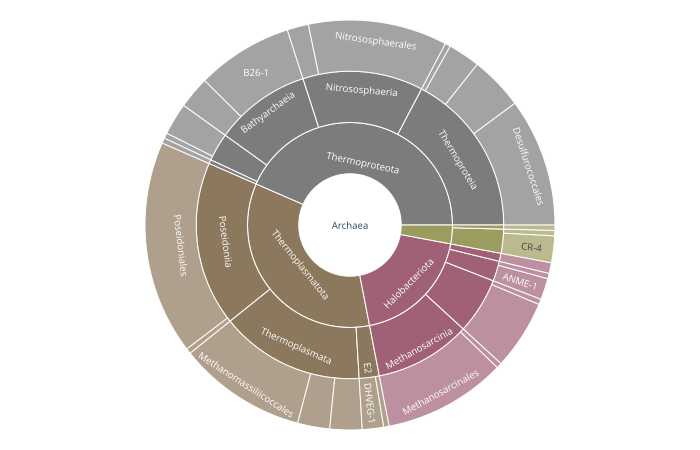

In [27]:
fig = px.sunburst(arch_df, path=['superkingdom', 'phylum', 'class', 'order'], values='count',
                  #color='phylum',# hover_data=['iso_alpha'],
                  #color_discrete_sequence=sns.color_palette("flare", arch_df.phylum.nunique()).as_hex(),)
                  color_discrete_sequence=px.colors.qualitative.Antique_r,)

fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))

fig.write_html('gtdb95-evolpaths-taxonomysunburst.archaea.order.antique_r.html', auto_open=True)
fig.show()
fig.show("svg")
#df.head()

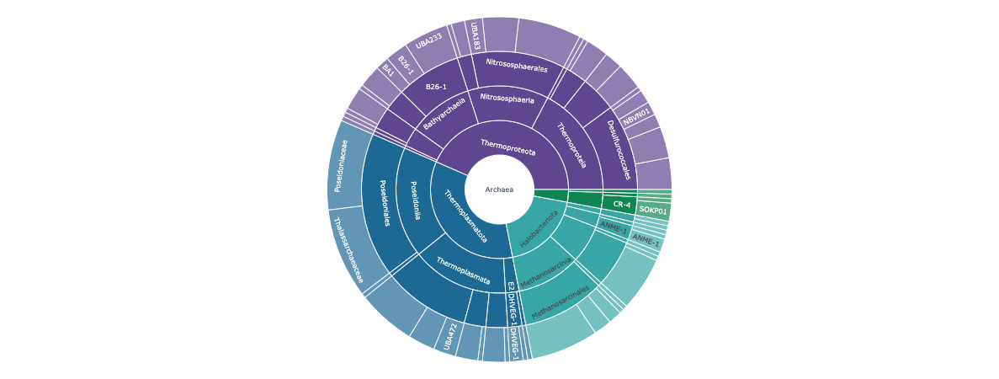

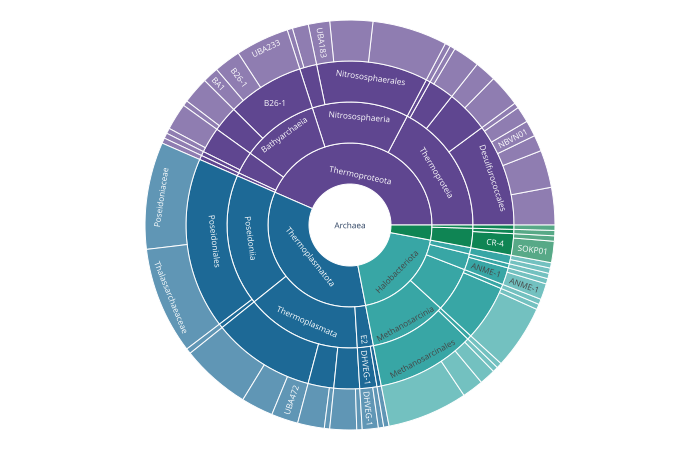

In [28]:
fig = px.sunburst(arch_df, path=['superkingdom', 'phylum', 'class', 'order', "family"], values='count',
                  #color='phylum',# hover_data=['iso_alpha'],
                  #color_discrete_sequence=sns.color_palette("flare", arch_df.phylum.nunique()).as_hex(),)
                  color_discrete_sequence=px.colors.qualitative.Prism,)

fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))

fig.write_html('gtdb95-evolpaths-taxonomysunburst.archaea.family.prism.html', auto_open=True)
fig.show()
fig.show("svg")
#df.head()

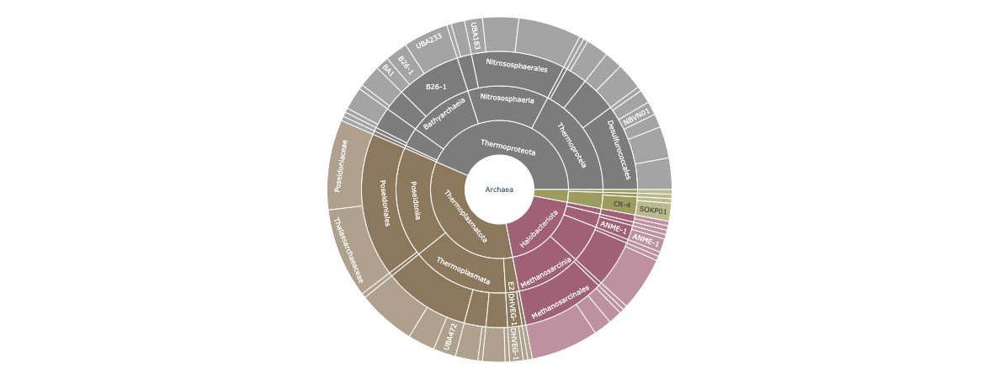

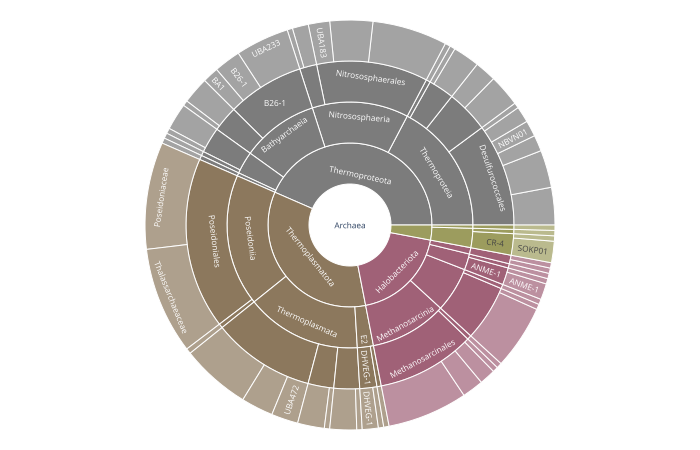

In [29]:
fig = px.sunburst(arch_df, path=['superkingdom', 'phylum', 'class', 'order', "family"], values='count',
                  #color='phylum',# hover_data=['iso_alpha'],
                  #color_discrete_sequence=sns.color_palette("flare", arch_df.phylum.nunique()).as_hex(),)
                  color_discrete_sequence=px.colors.qualitative.Antique_r,)

fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))

fig.write_html('gtdb95-evolpaths-taxonomysunburst.archaea.family.antique_r.html', auto_open=True)
fig.show()
fig.show("svg")
#df.head()

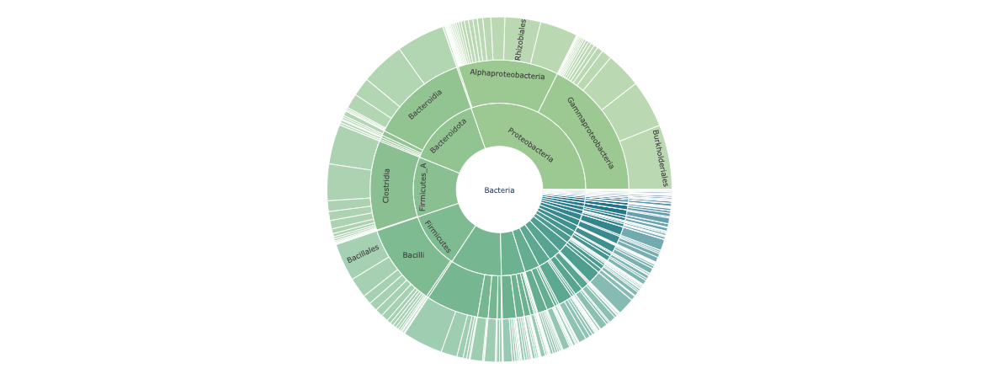

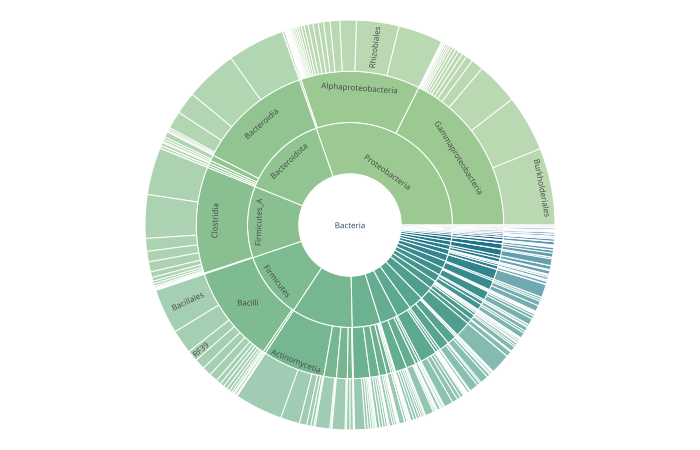

In [30]:
fig = px.sunburst(bact_df, path=['superkingdom', 'phylum', 'class', "order"], values='count',
                  #color="phylum",# hover_data=['iso_alpha'],
                  color_discrete_sequence=sns.color_palette("crest", bact_df.phylum.nunique()).as_hex(),)

fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))

fig.write_html('gtdb95-evolpaths-taxonomysunburst.bacteria.order.html', auto_open=True)
fig.show()
fig.show("svg")

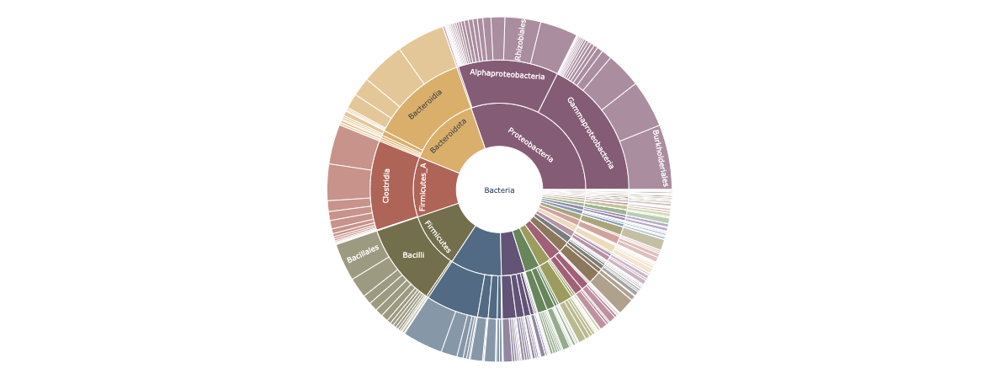

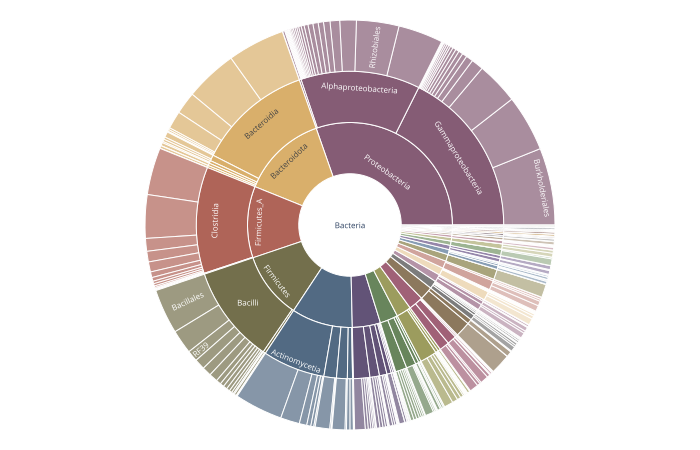

In [31]:
fig = px.sunburst(bact_df, path=['superkingdom', 'phylum', 'class', "order"], values='count',
                  #color="phylum",
                  color_discrete_sequence=px.colors.qualitative.Antique,)

fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))

fig.write_html('gtdb95-evolpaths-taxonomysunburst.bacteria.order.html', auto_open=True)
fig.show()
fig.show("svg")

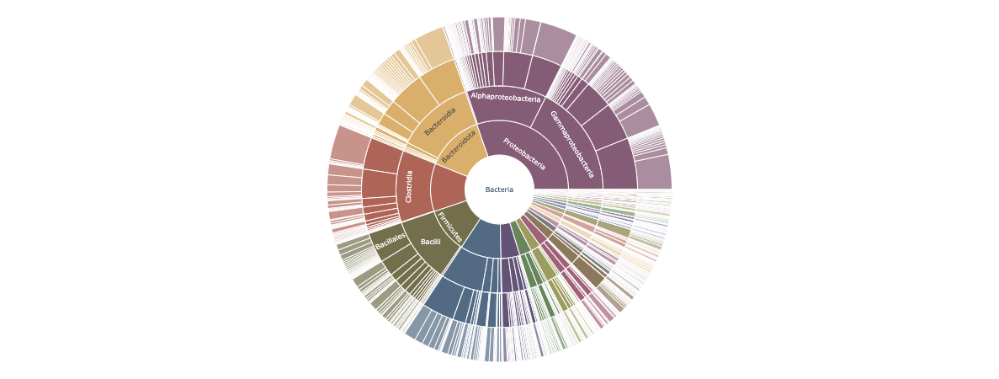

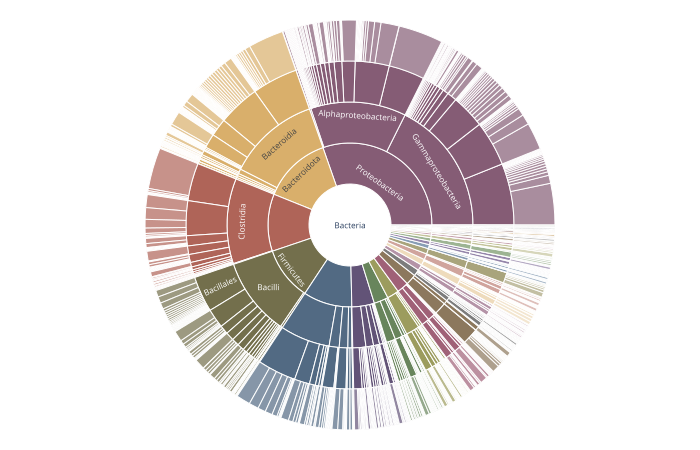

In [32]:
fig = px.sunburst(bact_df, path=['superkingdom', 'phylum', 'class', "order", "family"], values='count',
                  #color="phylum",
                  color_discrete_sequence=px.colors.qualitative.Antique,)
fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))
fig.write_html('gtdb95-evolpaths-taxonomysunburst.bacteria.family.html', auto_open=True)
fig.show()
fig.show("svg")

In [36]:
fig = px.sunburst(bact_df, path=['superkingdom', 'phylum', 'class', "order", "family", "genus"], values='count',
                  #color="phylum",# hover_data=['iso_alpha'],
                  color_discrete_sequence=px.colors.qualitative.Antique,)
                
fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))
fig.write_html('gtdb95-evolpaths-taxonomysunburst.bacteria.genus.html', auto_open=True)
#fig.show()
fig.show("svg")
#df.head()

In [37]:
fig = px.sunburst(bact_df, path=['superkingdom', 'phylum', 'class', "order", "family", "genus", "species"], values='count',
                  #color="phylum",# hover_data=['iso_alpha'],
                  color_discrete_sequence=px.colors.qualitative.Antique,)
                
fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))
fig.write_html('gtdb95-evolpaths-taxonomysunburst.bacteria.species.html', auto_open=True)
#fig.show()
fig.show("svg")
#df.head()

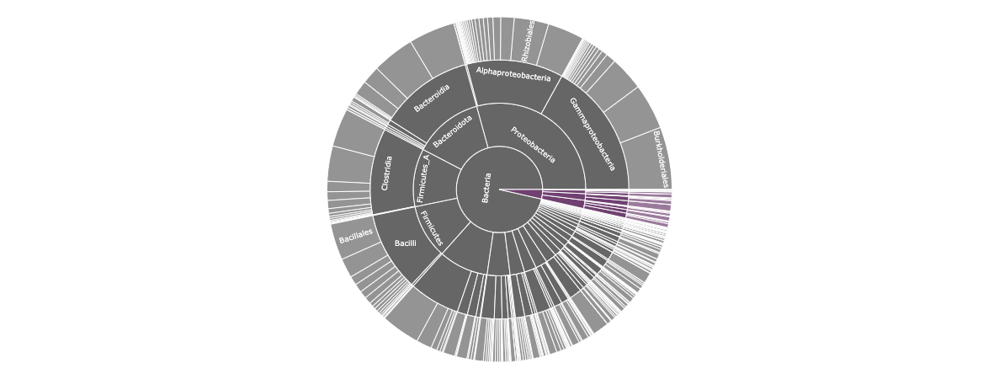

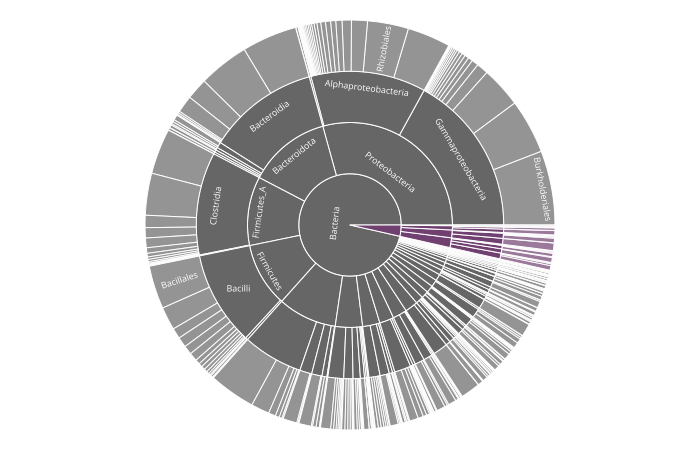

In [34]:
fig = px.sunburst(uDF, path=['superkingdom', 'phylum', 'class', "order"], values='count',
                  #color="phylum",# hover_data=['iso_alpha'],
                  color_discrete_sequence=px.colors.qualitative.Prism_r,)
                
fig.update_layout(uniformtext=dict(minsize=8, mode='hide'),margin=dict(l=20, r=20, t=20, b=20))
fig.write_html('gtdb95-evolpaths-taxonomysunburst.all.order.html', auto_open=True)
fig.show()
fig.show("svg")
#df.head()

## Describe number of included genomes from some lineages of interest

In [94]:
class_of_interest = "Gammaproteobacteria"
order_of_interest = "Burkholderiales"
family_of_interest = "Burkholderiaceae"
genus_of_interest = "Ralstonia"

classDF = uDF[uDF["class"] == class_of_interest]
print(f"Class: {class_of_interest} (number orders represented: {str(classDF.order.nunique())})\n")
print("Orders: " + ", ".join(classDF.order.unique())+ "\n")

ordDF = uDF[uDF["order"] == order_of_interest]
print(f"Order: {order_of_interest} (number families represented: {str(ordDF.family.nunique())})\n")
print("Families: " + ", ".join(ordDF.family.unique())+ "\n")

famDF = uDF[uDF["family"] == family_of_interest]
print(f"Family: {family_of_interest}; (number genuses represented: {str(famDF.genus.nunique())})\n")
print("Genuses: " + ", ".join(famDF.genus.unique())+ "\n")

genusDF = uDF[uDF["genus"] == genus_of_interest]
print(f"Genus: {genus_of_interest} (number species represented: {str(genusDF.species.nunique())})\n")
print("Species: " + ", ".join(genusDF.species.unique()))


#a. one genome for each order in the class Gammaproteobacteria
#b. one genome for each family in the order Burkholderiales
#c. one genome for each genus in the family Burkholderiaceae
#d. one genomes for each species in the genus Ralstonia
#e. our set of representative genomes in the Ralstonia solanacearum species complex.


Class: Gammaproteobacteria (number orders represented: 17)

Orders: Burkholderiales, Acidiferrobacterales, Acidithiobacillales, Enterobacterales, Cardiobacteriales, Chromatiales, Competibacterales, Ectothiorhodospirales, Methylococcales, Nevskiales, Nitrococcales, Nitrosococcales, Pseudomonadales, SAR86, Thiohalobacterales, UBA10353, Xanthomonadales

Order: Burkholderiales (number families represented: 19)

Families: Burkholderiaceae, Neisseriaceae, Aquaspirillaceae, Chitinibacteraceae, Chromobacteriaceae, Ferrovaceae, Ga0077523, Gallionellaceae, Hydrogenophilaceae, Methylophilaceae, Nitrosomonadaceae, Palsa-1005, Rhodocyclaceae, SG8-39, SG8-40, SG8-41, Sulfuricellaceae, Sulfuriferulaceae, Thiobacillaceae

Family: Burkholderiaceae; (number genuses represented: 105)

Genuses: Hylemonella, Pseudorhodoferax, ALPHA2B, Achromobacter, Acidovorax_A, Acidovorax_B, Acidovorax_C, Acidovorax_D, Advenella, Albidiferax, Alcaligenes, Aquabacterium, Azohydromonas, Bordetella, Bordetella_A, Bordetella

In [84]:
# make this a bit more automated ...
from collections import namedtuple

LOI = namedtuple("LineageOfInterest", "tclass,order,family,genus")

# make lineages of interest from trello board notes
loi_list = []
loi_list.append(LOI(tclass="Gammaproteobacteria", order="Burkholderiales",family="Burkholderiaceae",genus="Ralstonia"))
loi_list.append(LOI(tclass="Gammaproteobacteria", order="Xanthomonadales",family="Xanthomonadaceae",genus="Xylella"))
loi_list.append(LOI(tclass="Gammaproteobacteria", order="Enterobacterales",family="Enterobacteriaceae",genus="Pantoea"))
loi_list.append(LOI(tclass="Gammaproteobacteria", order="Pseudomonadales",family="Pseudomonadaceae",genus="Pseudomonas"))
loi_list.append(LOI(tclass="Bacilli", order="Lactobacillales",family="Listeriaceae",genus="Listeria"))
loi_list.append(LOI(tclass="Bacilli", order="Bacillales",family="Planococcaceae",genus="Lysinibacillus"))
loi_list.append(LOI(tclass="Actinomycetia", order="Streptomycetales",family="Streptomycetaceae",genus="Streptomyces"))

In [85]:
loi_list

[LineageOfInterest(tclass='Gammaproteobacteria', order='Burkholderiales', family='Burkholderiaceae', genus='Ralstonia'),
 LineageOfInterest(tclass='Gammaproteobacteria', order='Xanthomonadales', family='Xanthomonadaceae', genus='Xylella'),
 LineageOfInterest(tclass='Gammaproteobacteria', order='Enterobacterales', family='Enterobacteriaceae', genus='Pantoea'),
 LineageOfInterest(tclass='Gammaproteobacteria', order='Pseudomonadales', family='Pseudomonadaceae', genus='Pseudomonas'),
 LineageOfInterest(tclass='Bacilli', order='Lactobacillales', family='Listeriaceae', genus='Listeria'),
 LineageOfInterest(tclass='Bacilli', order='Bacillales', family='Planococcaceae', genus='Lysinibacillus'),
 LineageOfInterest(tclass='Actinomycetia', order='Streptomycetales', family='Streptomycetaceae', genus='Streptomyces')]

In [97]:
print("====================================")
for lin in loi_list:
    classDF = uDF[uDF["class"] == lin.tclass]
    print(f"Class: {class_of_interest} (number orders represented: {str(classDF.order.nunique())})\n")
    print("Orders: " + ", ".join(classDF.order.unique())+ "\n")

    ordDF = uDF[uDF["order"] == lin.order]
    print(f"Order: {order_of_interest} (number families represented: {str(ordDF.family.nunique())})\n")
    print("Families: " + ", ".join(ordDF.family.unique())+ "\n")

    famDF = uDF[uDF["family"] == lin.family]
    print(f"Family: {family_of_interest}; (number genuses represented: {str(famDF.genus.nunique())})\n")
    print("Genuses: " + ", ".join(famDF.genus.unique())+ "\n")

    genusDF = uDF[uDF["genus"] == lin.genus]
    print(f"Genus: {genus_of_interest} (number species represented: {str(genusDF.species.nunique())})\n")
    print("Genomes: ")
    genomes = pd.Series(genusDF.species.values,index=genusDF.accession).to_dict()
    for acc, species in genomes.items():
        print(f"{species}: {acc}")    
    
    print("====================================")

Class: Gammaproteobacteria (number orders represented: 17)

Orders: Burkholderiales, Acidiferrobacterales, Acidithiobacillales, Enterobacterales, Cardiobacteriales, Chromatiales, Competibacterales, Ectothiorhodospirales, Methylococcales, Nevskiales, Nitrococcales, Nitrosococcales, Pseudomonadales, SAR86, Thiohalobacterales, UBA10353, Xanthomonadales

Order: Burkholderiales (number families represented: 19)

Families: Burkholderiaceae, Neisseriaceae, Aquaspirillaceae, Chitinibacteraceae, Chromobacteriaceae, Ferrovaceae, Ga0077523, Gallionellaceae, Hydrogenophilaceae, Methylophilaceae, Nitrosomonadaceae, Palsa-1005, Rhodocyclaceae, SG8-39, SG8-40, SG8-41, Sulfuricellaceae, Sulfuriferulaceae, Thiobacillaceae

Family: Burkholderiaceae; (number genuses represented: 105)

Genuses: Hylemonella, Pseudorhodoferax, ALPHA2B, Achromobacter, Acidovorax_A, Acidovorax_B, Acidovorax_C, Acidovorax_D, Advenella, Albidiferax, Alcaligenes, Aquabacterium, Azohydromonas, Bordetella, Bordetella_A, Bordetella

## Full GTDB r95 stats

### Taxa encompassing the largest number of GTDB species clusters is given for each taxonomic rank.

(from https://gtdb.ecogenomic.org/stats/r95)

|Phylum | 	Class| 	Order| 	Family| 	Genus| 
|-	|-	|-	|-	|-	|
|Proteobacteria	9,474|Gammaproteobacteria	5,779|Burkholderiales	1,620|Burkholderiaceae	1,096|Streptomyces	571|
|Actinobacteriota	4,261|Alphaproteobacteria	3,659|Pseudomonadales	1,503|Flavobacteriaceae	871|Pseudomonas_E	476|
|Bacteroidota	3,781|Bacteroidia	3,524|Enterobacterales	1,448|Lachnospiraceae	805|Mycobacterium	287|
|Firmicutes	2,737|Actinomycetia	3,491|Bacteroidales	1,367|Rhodobacteraceae	754|Prevotella	280|
|Firmicutes_A	2,636|Bacilli	2,702|Flavobacteriales	1,304|Mycobacteriaceae	671|Streptococcus	270|
|Patescibacteria	1,131|Clostridia|2,361	Actinomycetales	1,246|Streptomycetaceae	635|Flavobacterium	239|
|Cyanobacteria	727|Cyanobacteriia	648|Rhizobiales	1,181|Enterobacteriaceae	613|Collinsella	223|
|Desulfobacterota	560|Paceibacteria	432|Mycobacteriales	1,128|Rhizobiaceae	607|Prochlorococcus_A	178|
|Halobacteriota	545|Coriobacteriia	409|Lachnospirales	866|Pseudomonadaceae	597|Vibrio	157
|Chloroflexota	520|Verrucomicrobiae	367|Lactobacillales	838|Sphingomonadaceae	511|Microbacterium	155|
